In [1]:

import pandas as pd

# Load CSV file in chunks if it's very large
file_path = 'data/togo-dapaong_qc.csv'
chunk_size = 10000  # Number of rows per chunk
# df = pd.read_csv(file_path, low_memory=False)  # Adjust or use chunks if needed
df = pd.read_csv(file_path, parse_dates=['Timestamp'])



In [2]:
# Preview the dataset
print(df.head())
print(df.info())

            Timestamp  GHI  DNI  DHI  ModA  ModB  Tamb    RH   WS  WSgust  \
0 2021-10-25 00:01:00 -1.3  0.0  0.0   0.0   0.0  24.8  94.5  0.9     1.1   
1 2021-10-25 00:02:00 -1.3  0.0  0.0   0.0   0.0  24.8  94.4  1.1     1.6   
2 2021-10-25 00:03:00 -1.3  0.0  0.0   0.0   0.0  24.8  94.4  1.2     1.4   
3 2021-10-25 00:04:00 -1.2  0.0  0.0   0.0   0.0  24.8  94.3  1.2     1.6   
4 2021-10-25 00:05:00 -1.2  0.0  0.0   0.0   0.0  24.8  94.0  1.3     1.6   

   WSstdev     WD  WDstdev   BP  Cleaning  Precipitation  TModA  TModB  \
0      0.4  227.6      1.1  977         0            0.0   24.7   24.4   
1      0.4  229.3      0.7  977         0            0.0   24.7   24.4   
2      0.3  228.5      2.9  977         0            0.0   24.7   24.4   
3      0.3  229.1      4.6  977         0            0.0   24.7   24.4   
4      0.4  227.5      1.6  977         0            0.0   24.7   24.4   

   Comments  
0       NaN  
1       NaN  
2       NaN  
3       NaN  
4       NaN  
<class '

In [3]:
# Summary statistics
summary_stats = df.describe()
print(summary_stats)


                           Timestamp            GHI            DNI  \
count                         525600  525600.000000  525600.000000   
mean   2022-04-25 12:00:30.000000768     230.555040     151.258469   
min              2021-10-25 00:01:00     -12.700000       0.000000   
25%              2022-01-24 06:00:45      -2.200000       0.000000   
50%              2022-04-25 12:00:30       2.100000       0.000000   
75%              2022-07-25 18:00:15     442.400000     246.400000   
max              2022-10-25 00:00:00    1424.000000    1004.500000   
std                              NaN     322.532347     250.956962   

                 DHI           ModA           ModB           Tamb  \
count  525600.000000  525600.000000  525600.000000  525600.000000   
mean      116.444352     226.144375     219.568588      27.751788   
min         0.000000       0.000000       0.000000      14.900000   
25%         0.000000       0.000000       0.000000      24.200000   
50%         2.500000    

 ## Data Quality Check

In [4]:
missing_values = df.isnull().sum()
missing_percentage = (missing_values / len(df)) * 100
print(missing_percentage)


Timestamp          0.0
GHI                0.0
DNI                0.0
DHI                0.0
ModA               0.0
ModB               0.0
Tamb               0.0
RH                 0.0
WS                 0.0
WSgust             0.0
WSstdev            0.0
WD                 0.0
WDstdev            0.0
BP                 0.0
Cleaning           0.0
Precipitation      0.0
TModA              0.0
TModB              0.0
Comments         100.0
dtype: float64


In [5]:
# Negative values in columns that should only contain positives
columns_to_check = ['GHI', 'DNI', 'DHI', 'WS', 'WSgust', 'Precipitation']
for column in columns_to_check:
    print(f"Anomalies in {column}: {df[df[column] < 0].shape[0]} rows")


Anomalies in GHI: 257385 rows
Anomalies in DNI: 0 rows
Anomalies in DHI: 0 rows
Anomalies in WS: 0 rows
Anomalies in WSgust: 0 rows
Anomalies in Precipitation: 0 rows


In [6]:
from scipy.stats import zscore

# Calculate Z-scores for outlier detection
numerical_cols = df.select_dtypes(include='number').columns
z_scores = df[numerical_cols].apply(zscore)

# Flag data points with |Z-score| > 3
outliers = (z_scores.abs() > 3).sum()
print(f"Outliers: {outliers}")


Outliers: GHI               305
DNI              1062
DHI              3415
ModA              137
ModB              206
Tamb                0
RH                  0
WS               3510
WSgust           3915
WSstdev          5753
WD                  0
WDstdev          3362
BP               1019
Cleaning          281
Precipitation    3338
TModA             153
TModB             609
Comments            0
dtype: int64


<Figure size 1000x600 with 0 Axes>

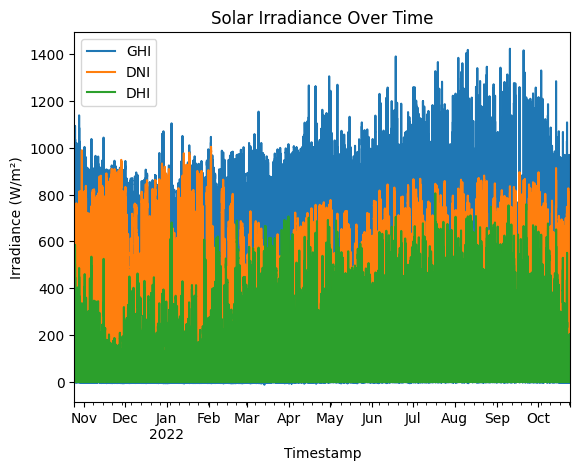

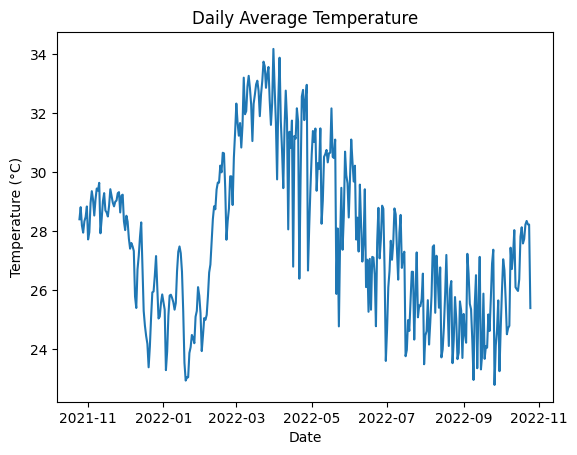

In [7]:
import matplotlib.pyplot as plt

# Plot GHI, DNI, DHI over time
plt.figure(figsize=(10, 6))
df.set_index('Timestamp')[['GHI', 'DNI', 'DHI']].plot()
plt.title('Solar Irradiance Over Time')
plt.ylabel('Irradiance (W/m²)')
plt.show()

# Daily temperature trends
df['Date'] = df['Timestamp'].dt.date
df.groupby('Date')['Tamb'].mean().plot(title='Daily Average Temperature')
plt.ylabel('Temperature (°C)')
plt.show()


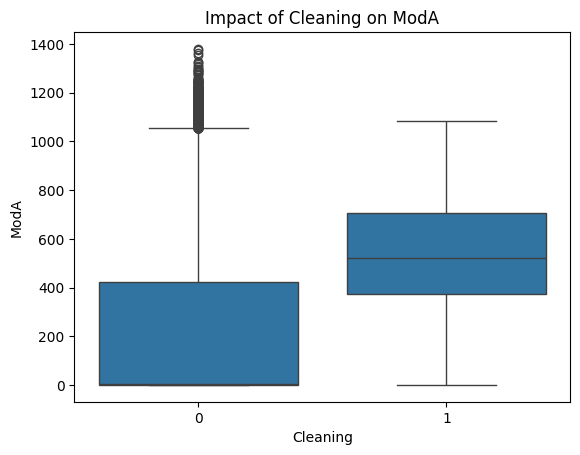

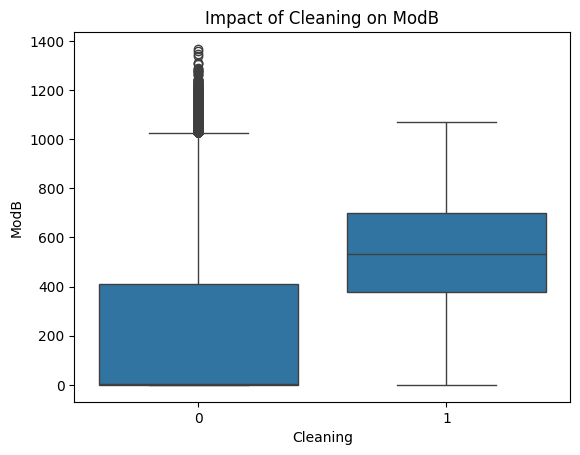

In [8]:
import seaborn as sns

# Compare ModA and ModB readings with and without cleaning
sns.boxplot(x='Cleaning', y='ModA', data=df)
plt.title('Impact of Cleaning on ModA')
plt.show()

sns.boxplot(x='Cleaning', y='ModB', data=df)
plt.title('Impact of Cleaning on ModB')
plt.show()


## Correlation Analysis
### Heatmap for Correlation

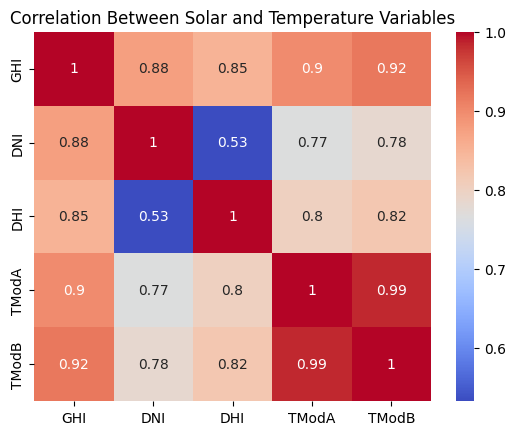

In [9]:
import seaborn as sns

correlation_matrix = df[['GHI', 'DNI', 'DHI', 'TModA', 'TModB']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Between Solar and Temperature Variables')
plt.show()


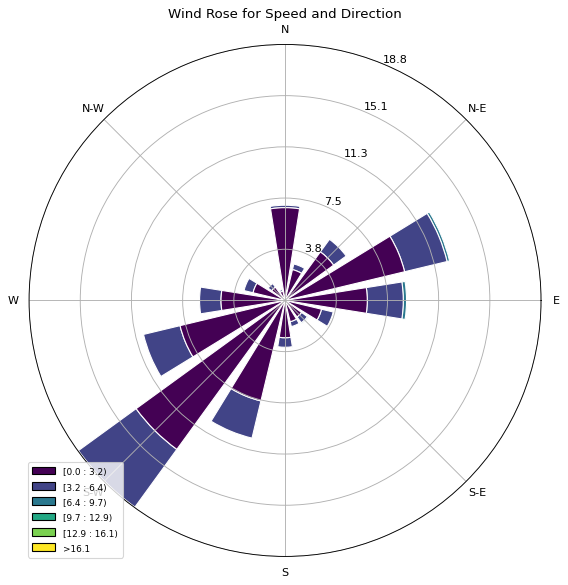

In [10]:
from windrose import WindroseAxes

# Create wind rose for wind speed and direction
ax = WindroseAxes.from_ax()
ax.bar(df['WD'], df['WS'], normed=True, opening=0.8, edgecolor='white')
ax.set_legend()
plt.title('Wind Rose for Speed and Direction')
plt.show()


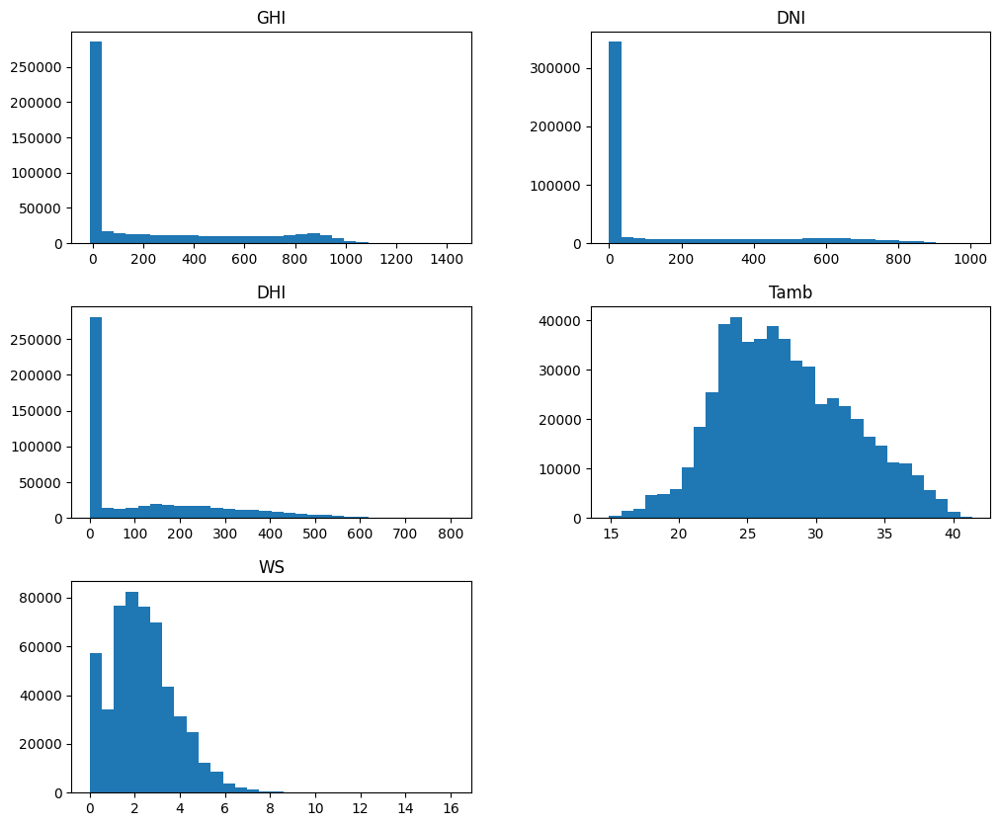

In [11]:
# Histograms for selected variables
columns = ['GHI', 'DNI', 'DHI', 'Tamb', 'WS']
df[columns].hist(figsize=(12, 10), bins=30, grid=False)
plt.show()


In [12]:


import plotly.express as px

# Bubble chart: GHI vs Tamb vs WS, bubble size = RH
fig = px.scatter(df, x='Tamb', y='GHI', size='RH', color='WS',
                 title='GHI vs Tamb vs WS with Bubble Size Representing RH',
                 labels={'GHI': 'Global Horizontal Irradiance (W/m²)',
                         'Tamb': 'Ambient Temperature (°C)',
                         'WS': 'Wind Speed (m/s)'})
fig.show()
